In [1]:
%cd ..
%ls

C:\Users\Dongmin Kim\Documents\OnlineTSAD
 C 드라이브의 볼륨에는 이름이 없습니다.
 볼륨 일련 번호: 067D-FB3E

 C:\Users\Dongmin Kim\Documents\OnlineTSAD 디렉터리

2023-04-12  오후 03:27    <DIR>          .
2023-04-12  오후 03:27    <DIR>          ..
2023-04-10  오후 01:01               156 .gitignore
2023-04-12  오후 04:01    <DIR>          .idea
2023-04-11  오후 05:37    <DIR>          cfgs
2023-04-12  오후 02:59    <DIR>          checkpoints
2023-04-09  오후 03:44    <DIR>          data
2023-04-09  오후 05:10    <DIR>          EDA
2023-04-12  오후 04:01    <DIR>          Exp
2023-04-12  오후 04:00    <DIR>          figures
2023-04-09  오후 02:54    <DIR>          hptune
2023-04-12  오후 02:17    <DIR>          logs
2023-04-11  오후 12:44    <DIR>          models
2023-04-12  오후 03:10    <DIR>          outputs
2023-04-12  오후 02:17    <DIR>          plots
2023-04-12  오후 02:17    <DIR>          results
2023-03-31  오후 06:12             3,657 test.py
2023-03-15  오후 03:49             3,099 train.py
2023-04-12  오후 04:01    <DIR>          util

In [36]:
import numpy as np
import matplotlib as mat
from matplotlib import font_manager, rc

def setPlotStyle():    
    #mat.rcParams['font.family'] = "serif"
    #mat.rcParams['font.serif'] = ["Arial"]
    mat.rcParams['font.family'] = "sans-serif"
    mat.rcParams['font.sans-serif'] = "Times new roman"
    mat.rcParams["axes.titlesize"] = "x-large"
    mat.rcParams['font.size'] = 15
    mat.rcParams['legend.fontsize'] = 15
    mat.rcParams['lines.linewidth'] = 2
    mat.rcParams['lines.color'] = 'r'
    mat.rcParams['axes.grid'] = 1     
    mat.rcParams['axes.xmargin'] = 0.1     
    mat.rcParams['axes.ymargin'] = 0.1     
    mat.rcParams["mathtext.fontset"] = "dejavuserif" #"cm", "stix", etc.
    mat.rcParams['figure.dpi'] = 500
    mat.rcParams['savefig.dpi'] = 500
setPlotStyle()

In [3]:
import torch
from torch import optim
import torch.nn.functional as F

import matplotlib.pyplot as plt

from utils.metrics import get_summary_stats

from models.MLP import MLP

import wandb
import hydra
from omegaconf import DictConfig

from utils.logger import make_logger
from utils.argpass import prepare_arguments, configure_exp_id
from utils.tools import SEED_everything, plot_interval

import warnings
from data.load_data import DataFactory
from Exp.ReconBaselines import *

from easydict import EasyDict as edict
import yaml
import re
import copy

warnings.filterwarnings("ignore")

# load yaml
cfg = {}
loader = yaml.SafeLoader
loader.add_implicit_resolver(
    u'tag:yaml.org,2002:float',
    re.compile(u'''^(?:
     [-+]?(?:[0-9][0-9_]*)\\.[0-9_]*(?:[eE][-+]?[0-9]+)?
    |[-+]?(?:[0-9][0-9_]*)(?:[eE][-+]?[0-9]+)
    |\\.[0-9_]+(?:[eE][-+][0-9]+)?
    |[-+]?[0-9][0-9_]*(?::[0-5]?[0-9])+\\.[0-9_]*
    |[-+]?\\.(?:inf|Inf|INF)
    |\\.(?:nan|NaN|NAN))$''', re.X),
    list(u'-+0123456789.'))

# get cfg
model = "MLP"
with open("cfgs/test_defaults.yaml", "r") as file:
    basic_config = yaml.load(file, Loader=loader)
    cfg.update(basic_config)
with open(f"cfgs/model/{model}.yaml", "r") as file:
    model_config = yaml.load(file, Loader=loader)
    cfg.update({"model": model_config})

In [4]:
cfg['dataset'] = 'SWaT'
cfg["RevIN"] = 'ARevIN'
cfg["gamma"] = 0.5
args = prepare_arguments(cfg)
print(args)

logger = make_logger(os.path.join(args.log_path, f'{args.exp_id}.log'))
logger.info(f"Configurations: {args}")

# Data
logger.info(f"Preparing {args.dataset} dataset...")
datafactory = DataFactory(args, logger)
train_dataset, train_loader, test_dataset, test_loader = datafactory()
args.num_channels = train_dataset.X.shape[1]
train_X, train_y, test_X, test_y = train_dataset.X, train_dataset.y, test_dataset.X, test_dataset.y

print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[2023-04-12 16:02:06,947] Configurations: {'exp_id': 'MLP_SWaT_RevIN_ARevIN', 'infer_options': ['offline', 'online_us_bce_seq_ARevIN'], 'dataset': 'SWaT', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'RevIN': 'ARevIN', 'gamma': 0.5, 'log_freq': 10, 'checkpoint_path': './checkpoints\\MLP_SWaT_RevIN_ARevIN', 'log_path': './logs\\MLP_SWaT_RevIN_ARevIN', 'output_path': './outputs\\MLP_SWaT_RevIN_ARevIN', 'plot_path': './plots\\MLP_SWaT_RevIN_ARevIN', 'result_path': './results\\MLP_SWaT_RevIN_ARevIN', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cpu')}
[2023-04-12 16:02:06,948] Preparing SWaT dataset...
[2023-04-12 16:02:06,950] current location: C:\Users\Dongmin Kim\Documents\Online

{'exp_id': 'MLP_SWaT_RevIN_ARevIN', 'infer_options': ['offline', 'online_us_bce_seq_ARevIN'], 'dataset': 'SWaT', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'RevIN': 'ARevIN', 'gamma': 0.5, 'log_freq': 10, 'checkpoint_path': './checkpoints\\MLP_SWaT_RevIN_ARevIN', 'log_path': './logs\\MLP_SWaT_RevIN_ARevIN', 'output_path': './outputs\\MLP_SWaT_RevIN_ARevIN', 'plot_path': './plots\\MLP_SWaT_RevIN_ARevIN', 'result_path': './results\\MLP_SWaT_RevIN_ARevIN', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'home_dir': '.', 'device': device(type='cpu')}


[2023-04-12 16:02:17,110] train: X - (496800, 51), y - (496800,) test: X - (449919, 51), y - (449919,)
[2023-04-12 16:02:17,214] Complete.
[2023-04-12 16:02:17,215] Preparing dataloader...
[2023-04-12 16:02:17,747] total train dataset- 7763, batch_X - torch.Size([64, 12, 51]), batch_y - torch.Size([64, 12])
[2023-04-12 16:02:17,748] total test dataset- 37493, batch_X - torch.Size([1, 12, 51]), batch_y - torch.Size([1, 12])
[2023-04-12 16:02:17,749] Complete.


(496800, 51) (496800,) (449916, 51) (449916,)


## Visualize

In [5]:
data_df = pd.read_csv("data/SWaT/SWaT_Dataset_Attack_v0.csv", index_col=0)
data_df

,FIT101,LIT101,MV101,P101,P102,AIT201,AIT202,AIT203,FIT201,MV201,...,P501,P502,PIT501,PIT502,PIT503,FIT601,P601,P602,P603,Normal/Attack
Timestamp,,,,,,,,,,,,,,,,,,,,,
28/12/2015 10:00:00 AM,2.427057,522.8467,2,2,1,262.0161,8.396437,328.6337,2.445391,2,...,2,1,250.8652,1.649953,189.5988,0.000128,1,1,1,Normal
28/12/2015 10:00:01 AM,2.446274,522.8860,2,2,1,262.0161,8.396437,328.6337,2.445391,2,...,2,1,250.8652,1.649953,189.6789,0.000128,1,1,1,Normal
28/12/2015 10:00:02 AM,2.489191,522.8467,2,2,1,262.0161,8.394514,328.6337,2.442316,2,...,2,1,250.8812,1.649953,189.6789,0.000128,1,1,1,Normal
28/12/2015 10:00:03 AM,2.534350,522.9645,2,2,1,262.0161,8.394514,328.6337,2.442316,2,...,2,1,250.8812,1.649953,189.6148,0.000128,1,1,1,Normal
28/12/2015 10:00:04 AM,2.569260,523.4748,2,2,1,262.0161,8.394514,328.6337,2.443085,2,...,2,1,250.8812,1.649953,189.5027,0.000128,1,1,1,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2/1/2016 2:59:55 PM,2.559972,519.5495,2,2,1,168.0979,8.638683,301.9226,2.459488,2,...,2,1,251.1535,0.865024,189.0220,0.000000,1,1,1,Normal
2/1/2016 2:59:56 PM,2.549082,520.4131,2,2,1,168.0979,8.638683,301.9226,2.459488,2,...,2,1,251.0734,0.865024,188.9259,0.000000,1,1,1,Normal
2/1/2016 2:59:57 PM,2.531467,520.6878,2,2,1,168.0979,8.638683,301.9226,2.460129,2,...,2,1,251.0734,0.865024,188.9259,0.000000,1,1,1,Normal


In [6]:
cols = list(data_df.columns)

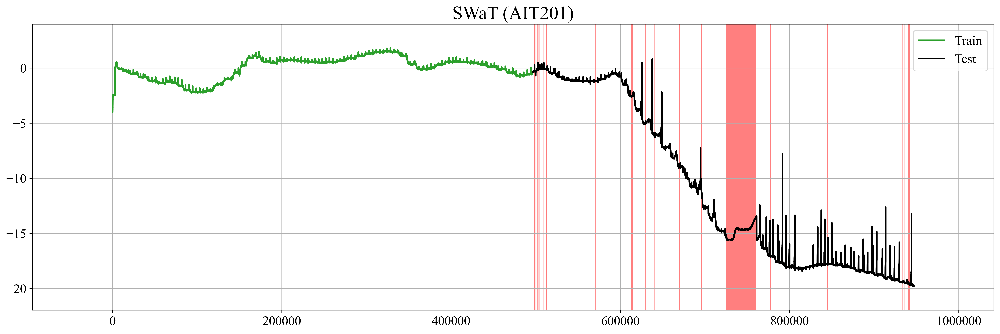

In [39]:
c = 5
dataset_name = "SWaT"

plt.figure(figsize=(20, 6), dpi=500)
plt.plot(train_X[:, c], color="C2", label="Train")
plt.plot(range(len(train_X), len(train_X)+len(test_X)), test_X[:, c], color="black", label="Test")
label = np.concatenate([np.array([0]*len(train_X)), test_y])
plot_interval(plt, label)
#plt.title(f"{dataset_name} ({cols[c]})")
plt.title(f"SWaT (AIT201)")

plt.legend()
plt.ticklabel_format(style="plain")
plt.show()

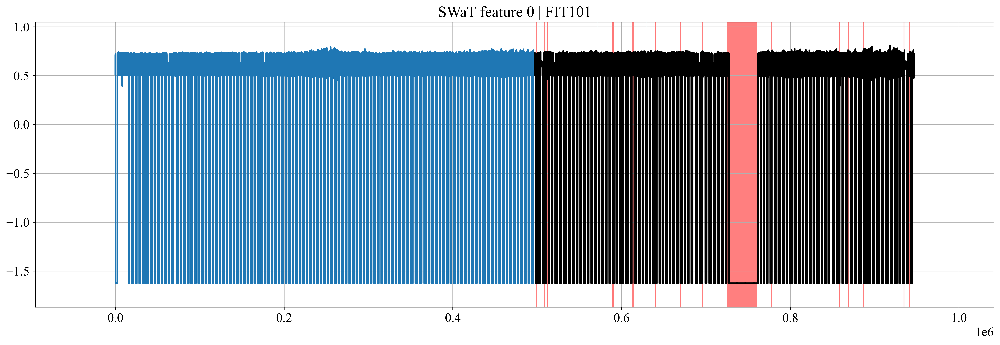

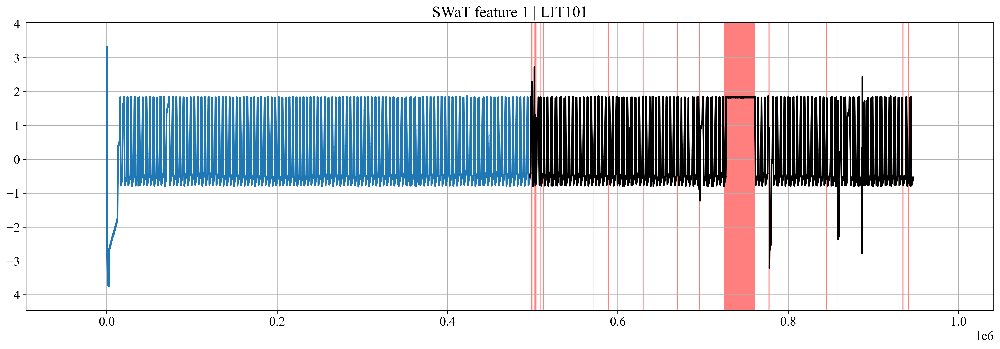

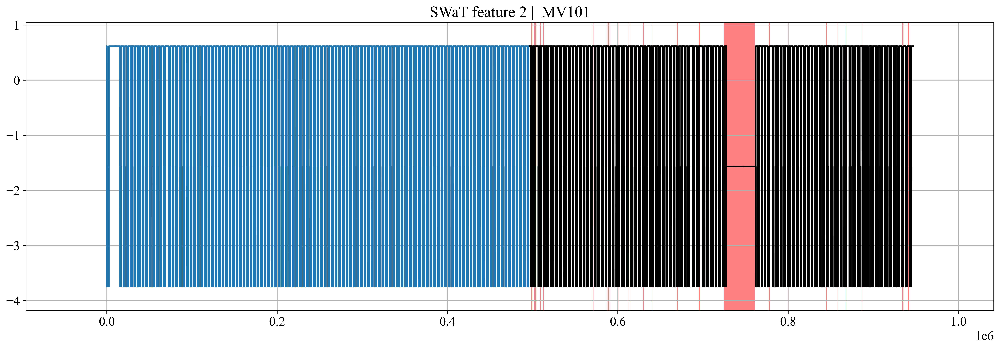

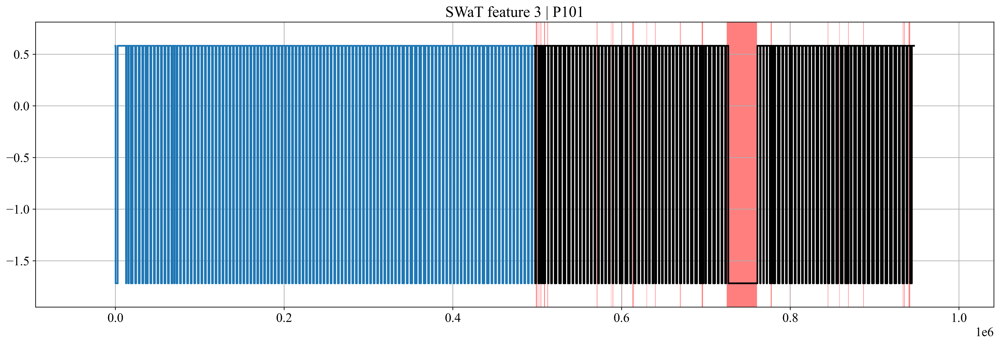

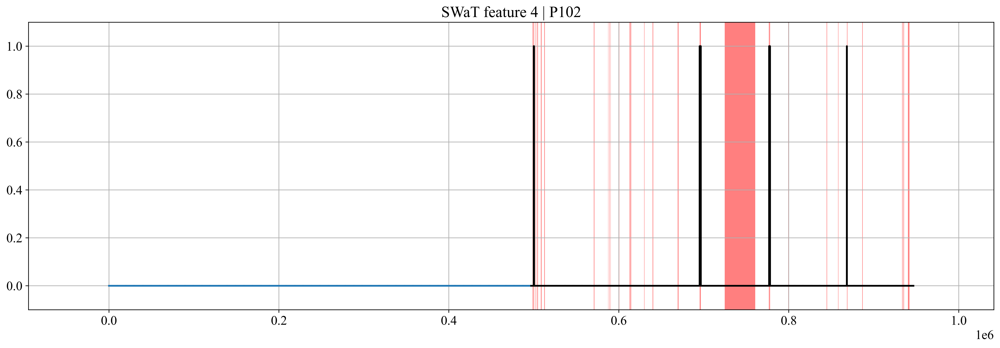

...

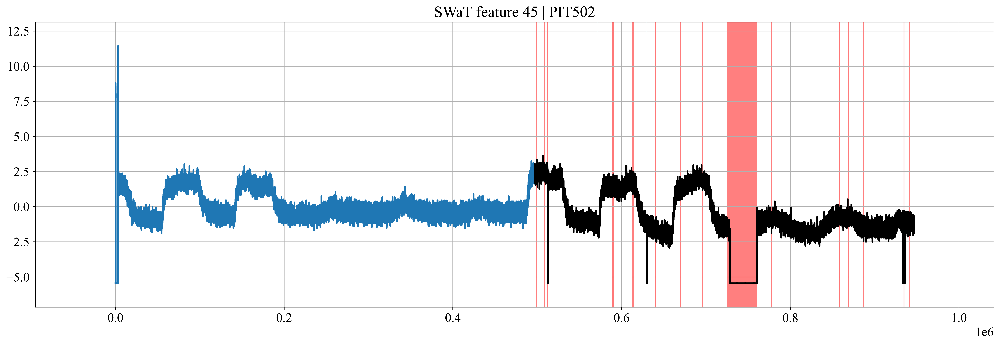

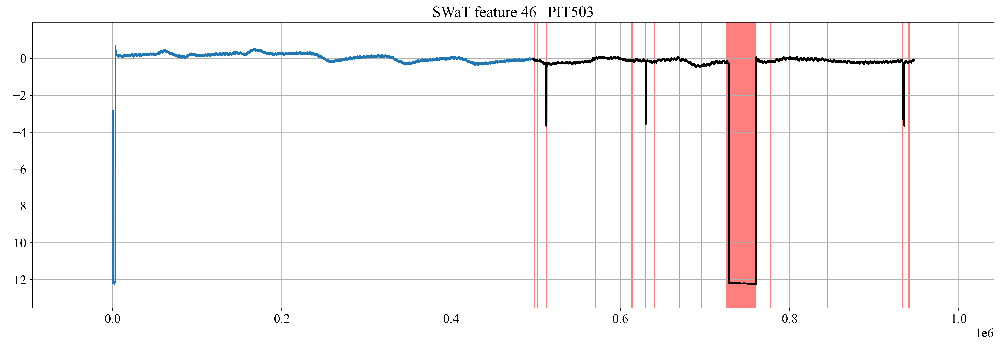

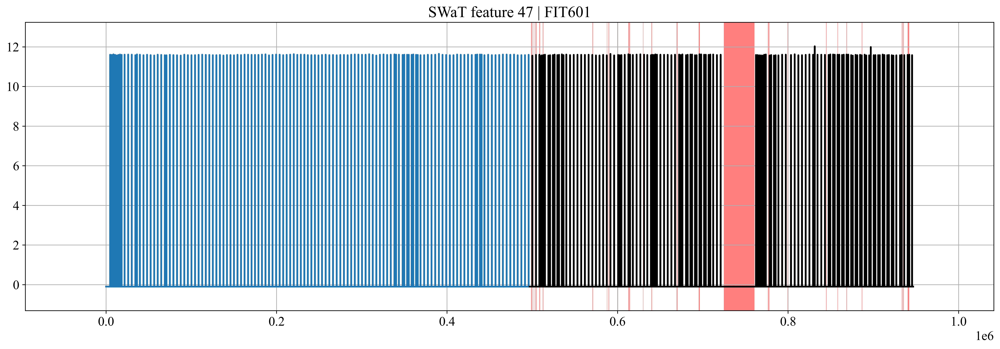

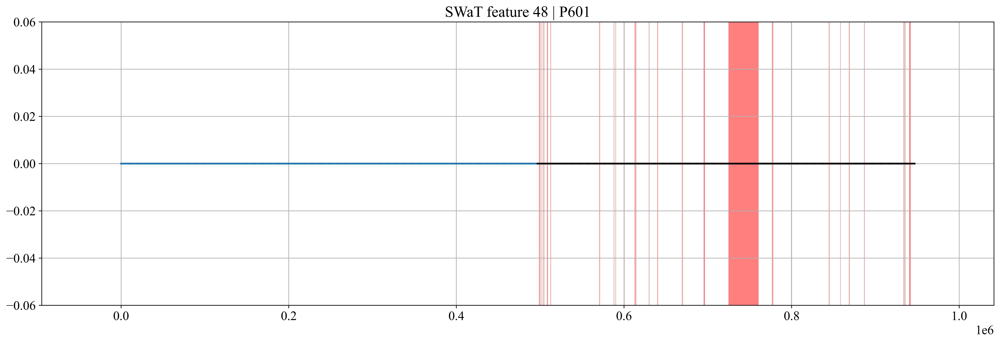

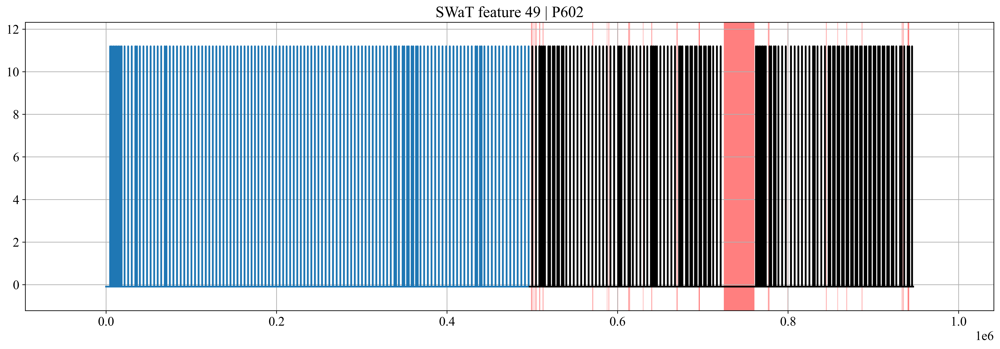

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "C:\Users\Dongmin Kim\Anaconda3\envs\OnlineTSAD\lib\site-packages\IPython\core\interactiveshell.py", line 3460, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "C:\Users\Dongmin Kim\AppData\Local\Temp\ipykernel_22636\2796551880.py", line 7, in <module>
    plot_interval(plt, label)
  File "C:\Users\Dongmin Kim\Documents\OnlineTSAD\utils\tools.py", line -1, in plot_interval
KeyboardInterrupt

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "C:\Users\Dongmin Kim\Anaconda3\envs\OnlineTSAD\lib\site-packages\IPython\core\interactiveshell.py", line 2057, in showtraceback
    stb = self.InteractiveTB.structured_traceback(
  File "C:\Users\Dongmin Kim\Anaconda3\envs\OnlineTSAD\lib\site-packages\IPython\core\ultratb.py", line 1118, in structured_traceback
    return FormattedTB.structured_traceback(
  File "C:\Users\Dongmin Kim\Anaconda3\envs\OnlineTSAD\lib\site-pack

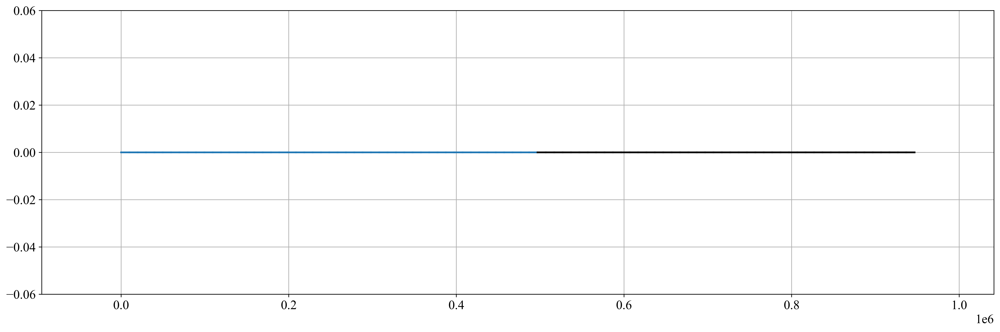

In [17]:
for c in range(args.num_channels):
    dataset_name = "SWaT"
    plt.figure(figsize=(20, 6), dpi=500)
    plt.plot(train_X[:, c], color="C0")
    plt.plot(range(len(train_X), len(train_X)+len(test_X)), test_X[:, c], color="black")
    label = np.concatenate([np.array([0]*len(train_X)), test_y])
    plot_interval(plt, label)
    plt.title(f"{dataset_name} feature {c} | {cols[c]}")
    plt.show()

## Training statistics

In [8]:
train_error_pt_path = os.path.join(args.output_path, "train_errors.pt")
with open(train_error_pt_path, 'rb') as f:
    train_errors = torch.load(f, map_location=torch.device('cpu'))
    
test_error_pt_path = os.path.join(args.output_path, "test_errors.pt")
with open(test_error_pt_path, 'rb') as f:
    test_errors = torch.load(f, map_location=torch.device('cpu'))
    
Xs_path = os.path.join(args.output_path, "Xs.pt")
with open(Xs_path, 'rb') as f:
    Xs = torch.load(f, map_location=torch.device('cpu'))
    
Xhats_offline_path = os.path.join(args.output_path, "Xhats_offline.pt")
with open(Xhats_offline_path, 'rb') as f:
    Xhats = torch.load(f, map_location=torch.device('cpu'))

In [9]:
train_errors.shape

torch.Size([496789, 12])

In [10]:
test_errors.shape

torch.Size([37493, 12])

In [11]:
Xs.shape, Xhats.shape

(torch.Size([37493, 12, 51]), torch.Size([37493, 12, 51]))

In [17]:
anoscs_prev = test_errors.reshape(-1)

## Test: static threshold inference

In [14]:
from utils.tools import get_best_static_threshold as gbst

In [18]:
th_q95 = torch.quantile(train_errors, 0.95).item()
th_q99 = torch.quantile(train_errors, 0.99).item()
th_q100 = torch.max(train_errors).item()
th_best_static = gbst(gt=test_y, anomaly_scores=anoscs_prev)
th_q95, th_q99, th_q100, th_best_static

(0.013343466445803642, 0.08965997397899628, 9.576774597167969, 9.518744)

In [19]:
# 95
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q95))
# 99
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q99))
# 100
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q100))
# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > th_best_static))

{'Accuracy': 0.2897963175348287, 'Precision': 0.1419873198099593, 'Recall': 0.9625348087351605, 'F1': 0.24746944254727868, 'tn': 77845, 'fp': 317487, 'fn': 2045, 'tp': 52539}
{'Accuracy': 0.36144969283155076, 'Precision': 0.1496091209135368, 'Recall': 0.910175142899018, 'F1': 0.2569777786973434, 'tn': 112941, 'fp': 282391, 'fn': 4903, 'tp': 49681}
{'Accuracy': 0.9493905529032086, 'Precision': 0.9459489767311466, 'Recall': 0.6181664956763887, 'F1': 0.7477120127639773, 'tn': 393404, 'fp': 1928, 'fn': 20842, 'tp': 33742}
{'Accuracy': 0.9494927942104748, 'Precision': 0.9453950679416205, 'Recall': 0.6194672431481753, 'F1': 0.7484892086330934, 'tn': 393379, 'fp': 1953, 'fn': 20771, 'tp': 33813}


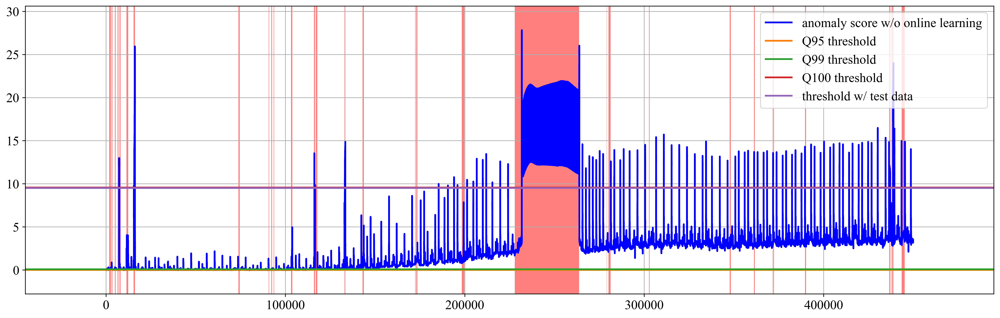

In [20]:
plt.figure(figsize=(20, 6))
plt.plot(anoscs_prev, color="blue", label="anomaly score w/o online learning")
plt.axhline(th_q95, color="C1", label="Q95 threshold")
plt.axhline(th_q99, color="C2", label="Q99 threshold")
plt.axhline(th_q100, color="C3", label="Q100 threshold")
plt.axhline(th_best_static, color="C4", label="threshold w/ test data")

plt.legend(loc=1)
plot_interval(plt, test_y)
plt.show()

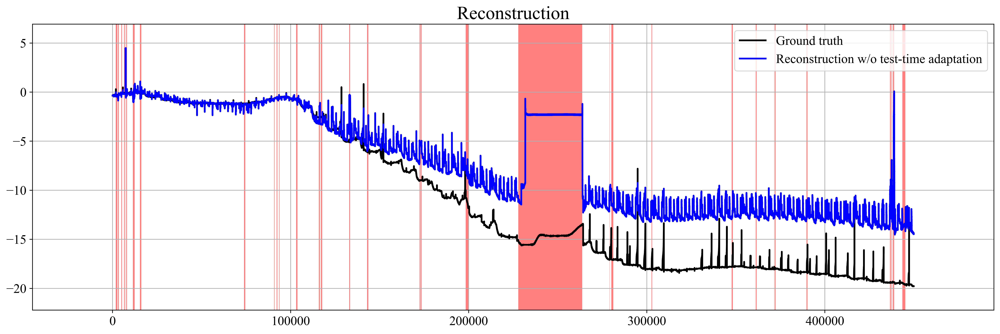

In [38]:
# plot recon
c = 5
test_X, test_y = test_dataset.X, test_dataset.y

B, L, C = Xhats.shape

plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"Reconstruction")
plt.plot(test_X[:, c], color="black", label="Ground truth")
plt.plot(Xhats[:,:,c].reshape(-1), color="blue", label="Reconstruction w/o test-time adaptation")
plt.legend(loc=1)
plot_interval(plt, test_y)

In [ ]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

In [ ]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([thr]+[p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals and update threshold
    TT_optimizer.zero_grad()
    mask = (y == 0)
    yhat = torch.sigmoid((A - thr))
    cls_loss = bce(yhat, y.float())
    recon_loss = (A * mask).mean()
    loss = recon_loss + cls_loss
    loss.backward()
    TT_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

In [ ]:
# result summary
print(test_y.shape, preds.shape)
result = get_summary_stats(test_y, preds)
print(result)

In [ ]:
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_label_bce_joint_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plt.legend()
plt.show()

In [ ]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(test_X[:, c], color="black", label="gt")
    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.legend()
    plot_interval(plt, test_y)